In [ ]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', None)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
train = pd.read_csv('/content/drive/MyDrive/minor data/train.csv',parse_dates=['date'])
test = pd.read_csv('/content/drive/MyDrive/minor data/test.csv',parse_dates=['date'])

# For feature engineering -> features have to generated both in test and train set
df = pd.concat([train, test], sort=False)

In [ ]:
train.head()

,date,store,item,sales
0,2013-01-01,1,1,13
1,2013-01-02,1,1,11
2,2013-01-03,1,1,14
3,2013-01-04,1,1,13
4,2013-01-05,1,1,10


In [ ]:
test.head()

,id,date,store,item
0,0,2018-01-01,1,1
1,1,2018-01-02,1,1
2,2,2018-01-03,1,1
3,3,2018-01-04,1,1
4,4,2018-01-05,1,1


In [ ]:
df

,date,store,item,sales,id
0,2013-01-01,1,1,13.0,NaN
1,2013-01-02,1,1,11.0,NaN
2,2013-01-03,1,1,14.0,NaN
3,2013-01-04,1,1,13.0,NaN
4,2013-01-05,1,1,10.0,NaN
...,...,...,...,...,...
44995,2018-03-27,10,50,NaN,44995.0
44996,2018-03-28,10,50,NaN,44996.0
44997,2018-03-29,10,50,NaN,44997.0
44998,2018-03-30,10,50,NaN,44998.0


In [ ]:
df["date"].min()

Timestamp('2013-01-01 00:00:00')

In [ ]:
df["date"].max()

Timestamp('2018-03-31 00:00:00')

In [ ]:
print(train.shape, test.shape, df.shape)

(913000, 4) (45000, 4) (958000, 5)


In [ ]:
df.isnull().sum() 

date          0
store         0
item          0
sales     45000
id       913000
dtype: int64

In [ ]:
train.isnull().sum() 

date     0
store    0
item     0
sales    0
dtype: int64

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 958000 entries, 0 to 44999
Data columns (total 5 columns):
 #   Column  Non-Null Count   Dtype         
---  ------  --------------   -----         
 0   date    958000 non-null  datetime64[ns]
 1   store   958000 non-null  int64         
 2   item    958000 non-null  int64         
 3   sales   913000 non-null  float64       
 4   id      45000 non-null   float64       
dtypes: datetime64[ns](1), float64(2), int64(2)
memory usage: 43.9 MB


In [ ]:
df.describe()

,store,item,sales,id
count,958000.000000,958000.000000,913000.000000,45000.000000
mean,5.500000,25.500000,52.250287,22499.500000
std,2.872283,14.430877,28.801144,12990.525394
min,1.000000,1.000000,0.000000,0.000000
25%,3.000000,13.000000,30.000000,11249.750000
50%,5.500000,25.500000,47.000000,22499.500000
75%,8.000000,38.000000,70.000000,33749.250000
max,10.000000,50.000000,231.000000,44999.000000


In [ ]:
df_non_indexed = df.copy()

In [ ]:
df_non_indexed 

,date,store,item,sales,id
0,2013-01-01,1,1,13.0,NaN
1,2013-01-02,1,1,11.0,NaN
2,2013-01-03,1,1,14.0,NaN
3,2013-01-04,1,1,13.0,NaN
4,2013-01-05,1,1,10.0,NaN
...,...,...,...,...,...
44995,2018-03-27,10,50,NaN,44995.0
44996,2018-03-28,10,50,NaN,44996.0
44997,2018-03-29,10,50,NaN,44997.0
44998,2018-03-30,10,50,NaN,44998.0


In [ ]:
df_indexed = df_non_indexed.set_index('date')

In [ ]:
df_indexed.index

DatetimeIndex(['2013-01-01', '2013-01-02', '2013-01-03', '2013-01-04',
               '2013-01-05', '2013-01-06', '2013-01-07', '2013-01-08',
               '2013-01-09', '2013-01-10',
               ...
               '2018-03-22', '2018-03-23', '2018-03-24', '2018-03-25',
               '2018-03-26', '2018-03-27', '2018-03-28', '2018-03-29',
               '2018-03-30', '2018-03-31'],
              dtype='datetime64[ns]', name='date', length=958000, freq=None)

In [ ]:
df_indexed.head()

,store,item,sales,id
date,,,,
2013-01-01,1,1,13.0,NaN
2013-01-02,1,1,11.0,NaN
2013-01-03,1,1,14.0,NaN
2013-01-04,1,1,13.0,NaN
2013-01-05,1,1,10.0,NaN


In [ ]:
df_indexed.loc['2013-01-01': '2013-01-05']

,store,item,sales,id
date,,,,
2013-01-01,1,1,13.0,NaN
2013-01-02,1,1,11.0,NaN
2013-01-03,1,1,14.0,NaN
2013-01-04,1,1,13.0,NaN
2013-01-05,1,1,10.0,NaN
...,...,...,...,...
2013-01-01,10,50,33.0,NaN
2013-01-02,10,50,37.0,NaN
2013-01-03,10,50,46.0,NaN


In [ ]:
train.store.nunique(), test.store.nunique(), train.item.nunique(), test.item.nunique(), df.item.nunique(), df.store.nunique()

(10, 10, 50, 50, 50, 10)

In [ ]:
train_non_indexed = train.copy()
train_indexed = train_non_indexed.set_index('date')
train_indexed.head()

,store,item,sales
date,,,
2013-01-01,1,1,13
2013-01-02,1,1,11
2013-01-03,1,1,14
2013-01-04,1,1,13
2013-01-05,1,1,10


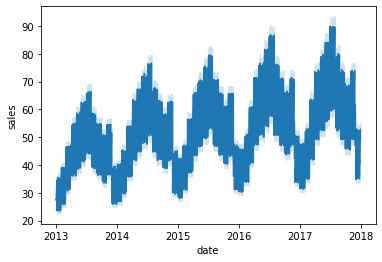

In [ ]:
sns.lineplot(x="date",y="sales",data=train)
plt.show()

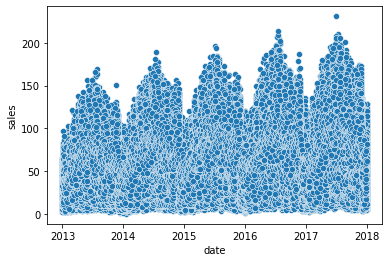

In [ ]:
sns.scatterplot(x="date",y="sales",data=train)
plt.show()

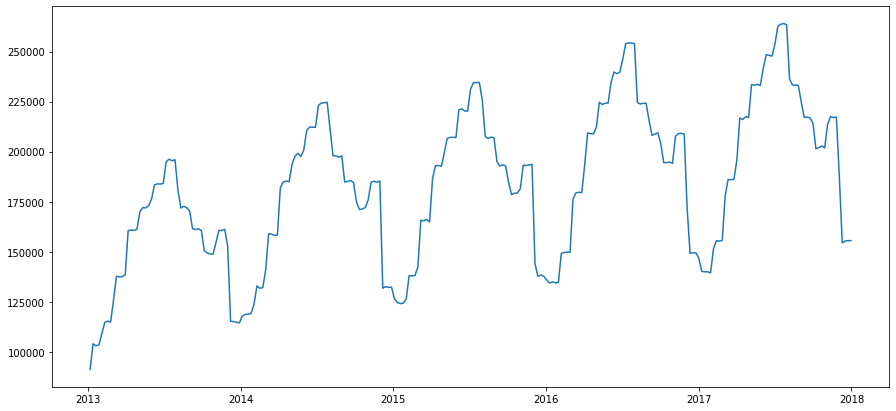

In [ ]:
plt.figure(figsize=(15,7))
plt.plot(train.set_index('date')['sales'].resample('W').sum(),label="sales")
plt.show()

## Analyzing Sales through stores

In [ ]:
df.groupby("store").agg({"sales": ["sum", "mean", "median", "std"]})

sales                             
             sum       mean median        std
store                                        
1      4315603.0  47.268379   44.0  24.006252
2      6120128.0  67.033165   62.0  33.595810
3      5435144.0  59.530602   55.0  29.974102
4      5012639.0  54.902946   51.0  27.733097
5      3631016.0  39.770164   37.0  20.365757
6      3627670.0  39.733516   37.0  20.310451
7      3320009.0  36.363735   34.0  18.684825
8      5856169.0  64.142048   60.0  32.231751
9      5025976.0  55.049025   51.0  27.832186
10     5360158.0  58.709288   54.0  29.554994

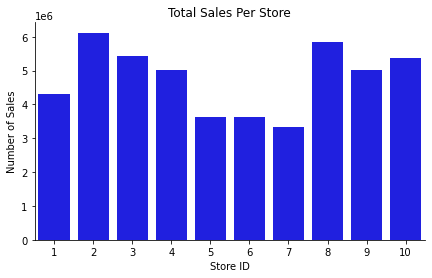

In [ ]:
def sales_per_store():
    by_store = df.groupby('store')['sales'].sum().reset_index()
    
    fig, ax = plt.subplots(figsize=(7,4))
    sns.barplot(by_store.store, by_store.sales, color='blue')
    
    ax.set(xlabel = "Store ID",
           ylabel = "Number of Sales",
           title = "Total Sales Per Store")
    
    sns.despine()
    
sales_per_store()

## Analyze Sales through item

In [ ]:
df.groupby(["item"]).agg({"sales": ["count","sum", "mean", "median", "std", "min", "max"]})

sales                                                     
      count        sum       mean median        std   min    max
item                                                            
1     18260   401384.0  21.981599   21.0   8.468922   1.0   59.0
2     18260  1069564.0  58.574151   56.0  20.093015   9.0  150.0
3     18260   669087.0  36.642223   35.0  13.179441   7.0  104.0
4     18260   401907.0  22.010241   21.0   8.403898   0.0   66.0
5     18260   335230.0  18.358708   18.0   7.265167   1.0   50.0
6     18260  1068281.0  58.503888   56.0  20.174898  11.0  148.0
7     18260  1068777.0  58.531051   56.0  20.146002  11.0  141.0
8     18260  1405108.0  76.950055   74.0  26.130697  15.0  181.0
9     18260   938379.0  51.389869   49.5  17.790158   6.0  134.0
10    18260  1337133.0  73.227437   70.0  24.823725  14.0  175.0
11    18260  1271925.0  69.656353   67.0  23.744732  11.0  170.0
12    18260  1271534.0  69.634940   67.0  23.738663  12.0  170.0
13    18260  1539621.0  84.316594   81.0  28.311031  20.0  210.0
14    18260  1071531.0  58.681873   56.0  20.079860  12.0  152.0
15    18260  1607442.0  88.030778   85.0  29.522852  17.0  231.0
16    18260   468480.0  25.656079   25.0   9.603270   2.0   70.0
17    18260   602486.0  32.994852   32.0  11.967610   4.0   83.0
18    18260  1538876.0  84.275794   81.0  28.430621  18.0  208.0
19    18260   736892.0  40.355531   39.0  14.332645   5.0   99.0
20    18260   867641.0  47.515936   46.0  16.490487   9.0  127.0
21    18260   736190.0  40.317087   39.0  14.338006   7.0  109.0
22    18260  1469971.0  80.502245   78.0  27.118163  14.0  214.0
23    18260   534979.0  29.297864   28.0  10.819549   3.0   81.0
24    18260  1205975.0  66.044633   64.0  22.531555  14.0  156.0
25    18260  1473334.0  80.686418   78.0  27.238817  18.0  193.0
26    18260   869981.0  47.644085   46.0  16.723912   8.0  119.0
27    18260   402628.0  22.049726   21.0   8.461641   1.0   59.0
28    18260  1604713.0  87.881325   85.0  29.501781  16.0  206.0
29    18260  1271240.0  69.618839   67.0  23.635631  15.0  173.0
30    18260   736554.0  40.337021   39.0  14.363331   5.0  115.0
31    18260  1070845.0  58.644304   57.0  20.104705  10.0  159.0
32    18260   803107.0  43.981763   42.0  15.574556   5.0  119.0
33    18260  1270183.0  69.560953   67.0  23.718343  15.0  169.0
34    18260   469935.0  25.735761   25.0   9.617910   2.0   79.0
35    18260  1201541.0  65.801807   63.0  22.461990  12.0  168.0
36    18260  1406548.0  77.028916   74.0  26.067440  16.0  188.0
37    18260   534258.0  29.258379   28.0  10.771547   3.0   74.0
38    18260  1470330.0  80.521906   77.0  27.141799  15.0  188.0
39    18260   801311.0  43.883406   42.0  15.511550   7.0  112.0
40    18260   534094.0  29.249398   28.0  10.822959   3.0   74.0
41    18260   401759.0  22.002136   21.0   8.402470   2.0   60.0
42    18260   669925.0  36.688116   35.0  13.215112   5.0   96.0
43    18260   936635.0  51.294359   49.0  17.801008   9.0  126.0
44    18260   536811.0  29.398193   28.0  10.797738   3.0   78.0
45    18260  1471467.0  80.584173   78.0  27.318402  18.0  205.0
46    18260  1070764.0  58.639869   56.0  20.220879  11.0  150.0
47    18260   401781.0  22.003341   21.0   8.420102   2.0   61.0
48    18260   937703.0  51.352848   49.0  17.881917   8.0  130.0
49    18260   535663.0  29.335323   28.0  10.874788   3.0   77.0
50    18260  1203009.0  65.882202   63.0  22.416031  12.0  164.0

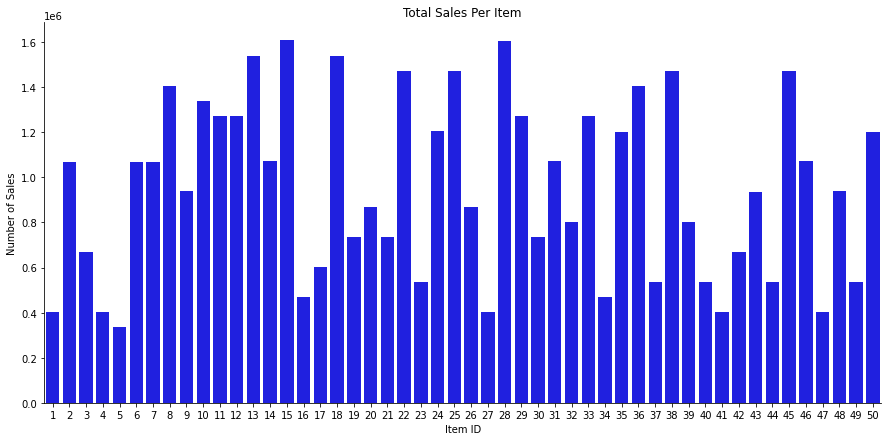

In [ ]:
def sales_per_item():
    by_item = df.groupby('item')['sales'].sum().reset_index()
    
    fig, ax = plt.subplots(figsize=(15,7))
    sns.barplot(by_item.item, by_item.sales, color='blue')
    
    ax.set(xlabel = "Item ID",
           ylabel = "Number of Sales",
           title = "Total Sales Per Item")
    
    sns.despine()
    
sales_per_item()

In [ ]:
df['year'] = df['date'].dt.year  # extracting year
df['month'] = df['date'].dt.month # extracting months
df['day'] = df['date'].dt.day # extracting days
df['dayofweek'] = df['date'].dt.dayofweek # extracting day of week

df

,date,store,item,sales,id,year,month,day,dayofweek
0,2013-01-01,1,1,13.0,NaN,2013,1,1,1
1,2013-01-02,1,1,11.0,NaN,2013,1,2,2
2,2013-01-03,1,1,14.0,NaN,2013,1,3,3
3,2013-01-04,1,1,13.0,NaN,2013,1,4,4
4,2013-01-05,1,1,10.0,NaN,2013,1,5,5
...,...,...,...,...,...,...,...,...,...
44995,2018-03-27,10,50,NaN,44995.0,2018,3,27,1
44996,2018-03-28,10,50,NaN,44996.0,2018,3,28,2
44997,2018-03-29,10,50,NaN,44997.0,2018,3,29,3
44998,2018-03-30,10,50,NaN,44998.0,2018,3,30,4


In [ ]:
train['year'] = train['date'].dt.year  # extracting year
train['quarter'] = train['date'].dt.quarter # extracting quarter
train['month'] = train['date'].dt.month # extracting months
train['day'] = train['date'].dt.day # extracting days
train['dayofweek'] = train['date'].dt.dayofweek

train

,date,store,item,sales,year,quarter,month,day,dayofweek
0,2013-01-01,1,1,13,2013,1,1,1,1
1,2013-01-02,1,1,11,2013,1,1,2,2
2,2013-01-03,1,1,14,2013,1,1,3,3
3,2013-01-04,1,1,13,2013,1,1,4,4
4,2013-01-05,1,1,10,2013,1,1,5,5
...,...,...,...,...,...,...,...,...,...
912995,2017-12-27,10,50,63,2017,4,12,27,2
912996,2017-12-28,10,50,59,2017,4,12,28,3
912997,2017-12-29,10,50,74,2017,4,12,29,4
912998,2017-12-30,10,50,62,2017,4,12,30,5


Changes by Year

In [ ]:
agg_year_item = pd.pivot_table(train, index='year', columns='item',
                               values='sales', aggfunc=np.mean).values

In [ ]:
agg_year_store = pd.pivot_table(train, index='year', columns='store',
                                values='sales', aggfunc=np.mean).values

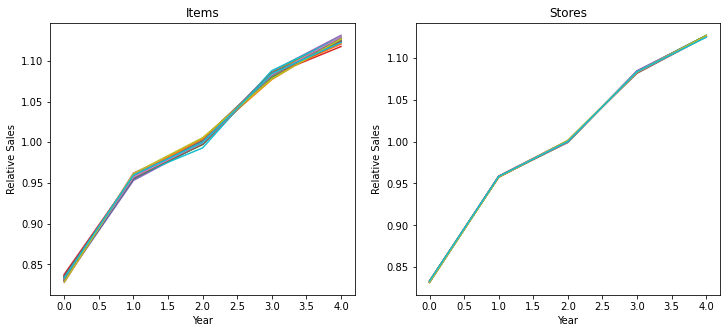

In [ ]:
plt.figure(figsize=(12, 5))
plt.subplot(121)
plt.plot(agg_year_item / agg_year_item.mean(0)[np.newaxis])
plt.title("Items")
plt.xlabel("Year")
plt.ylabel("Relative Sales")

plt.subplot(122)
plt.plot(agg_year_store / agg_year_store.mean(0)[np.newaxis])
plt.title("Stores")
plt.xlabel("Year")
plt.ylabel("Relative Sales")
plt.show()

In [ ]:
# All items and stores seem to has a similar growth in sales over the years.

Changes by month

In [ ]:
agg_month_item = pd.pivot_table(train, index='month', columns='item',
                                values='sales', aggfunc=np.mean).values

In [ ]:
agg_month_store = pd.pivot_table(train, index='month', columns='store',
                                 values='sales', aggfunc=np.mean).values

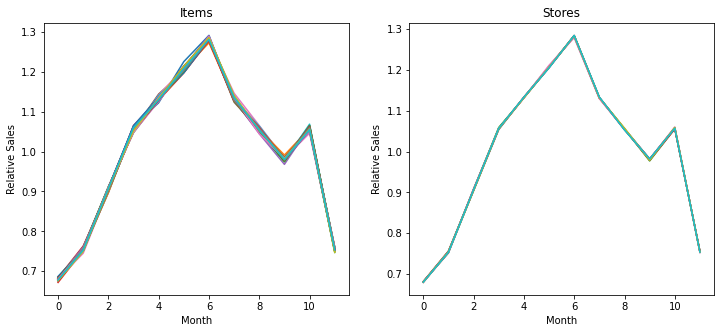

In [ ]:
plt.figure(figsize=(12, 5))
plt.subplot(121)
plt.plot(agg_month_item / agg_month_item.mean(0)[np.newaxis])
plt.title("Items")
plt.xlabel("Month")
plt.ylabel("Relative Sales")

plt.subplot(122)
plt.plot(agg_month_store / agg_month_store.mean(0)[np.newaxis])
plt.title("Stores")
plt.xlabel("Month")
plt.ylabel("Relative Sales")
plt.show()


In [ ]:
# All items and stores seem to share a common pattern in sales over the months as well.

Changes by day of week

In [ ]:
agg_dow_item = pd.pivot_table(train, index='dayofweek', columns='item',
                              values='sales', aggfunc=np.mean).values


In [ ]:
agg_dow_store = pd.pivot_table(train, index='dayofweek', columns='store',
                               values='sales', aggfunc=np.mean).values

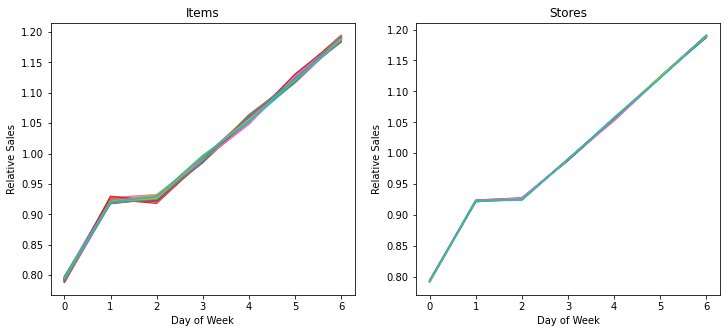

In [ ]:
plt.figure(figsize=(12, 5))
plt.subplot(121)
plt.plot(agg_dow_item / agg_dow_item.mean(0)[np.newaxis])
plt.title("Items")
plt.xlabel("Day of Week")
plt.ylabel("Relative Sales")

plt.subplot(122)
plt.plot(agg_dow_store / agg_dow_store.mean(0)[np.newaxis])
plt.title("Stores")
plt.xlabel("Day of Week")
plt.ylabel("Relative Sales")
plt.show()

Changes by day

In [ ]:
agg_day_item = pd.pivot_table(train, index='day', columns='item',
                              values='sales', aggfunc=np.mean).values


In [ ]:
agg_day_store = pd.pivot_table(train, index='day', columns='store',
                               values='sales', aggfunc=np.mean).values

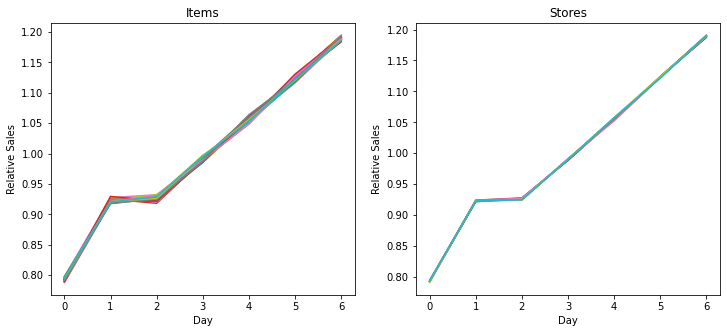

In [ ]:
plt.figure(figsize=(12, 5))
plt.subplot(121)
plt.plot(agg_dow_item / agg_dow_item.mean(0)[np.newaxis])
plt.title("Items")
plt.xlabel("Day")
plt.ylabel("Relative Sales")

plt.subplot(122)
plt.plot(agg_dow_store / agg_dow_store.mean(0)[np.newaxis])
plt.title("Stores")
plt.xlabel("Day")
plt.ylabel("Relative Sales")
plt.show()

In [ ]:
# Checking degeneracies

# not to miss important trends in datasets
#  For example, when looking at the monthly patterns, we average over all days of the month, years and either items or stores. 
# But what if sales have a multi-dimensional dependence on two of these parameters that isn't easily separable? So, always check for degeneracies in the data!

In [ ]:
agg_dow_month = pd.pivot_table(train, index='dayofweek', columns='month',
                               values='sales', aggfunc=np.mean).values

In [ ]:
agg_month_year = pd.pivot_table(train, index='month', columns='year',
                                values='sales', aggfunc=np.mean).values

In [ ]:
agg_dow_year = pd.pivot_table(train, index='dayofweek', columns='year',
                              values='sales', aggfunc=np.mean).values

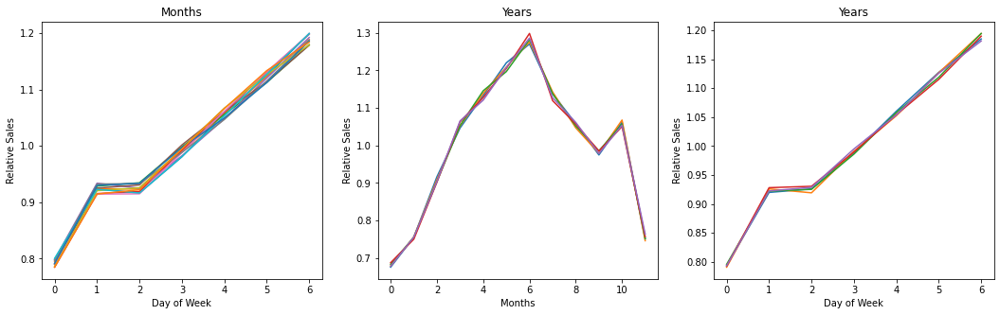

In [ ]:
plt.figure(figsize=(18, 5))
plt.subplot(131)
plt.plot(agg_dow_month / agg_dow_month.mean(0)[np.newaxis])
plt.title("Months")
plt.xlabel("Day of Week")
plt.ylabel("Relative Sales")
plt.subplot(132)

plt.plot(agg_month_year / agg_month_year.mean(0)[np.newaxis])
plt.title("Years")
plt.xlabel("Months")
plt.ylabel("Relative Sales")
plt.subplot(133)

plt.plot(agg_dow_year / agg_dow_year.mean(0)[np.newaxis])
plt.title("Years")
plt.xlabel("Day of Week")
plt.ylabel("Relative Sales")
plt.show()

In [ ]:
# no degeneracies
# We can effectively treat the "month", "year", "day of the week", "item" and "store" as completely independent modifiers to sales prediction. 

Item-Store Relationship

In [ ]:
agg_store_item = pd.pivot_table(train, index='store', columns='item',
                                values='sales', aggfunc=np.mean).values


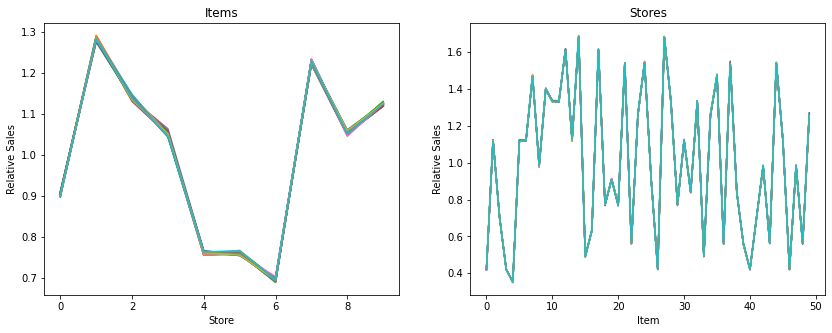

In [ ]:
plt.figure(figsize=(14, 5))
plt.subplot(121)
plt.plot(agg_store_item / agg_store_item.mean(0)[np.newaxis])
plt.title("Items")
plt.xlabel("Store")
plt.ylabel("Relative Sales")

plt.subplot(122)
plt.plot(agg_store_item.T / agg_store_item.T.mean(0)[np.newaxis])
plt.title("Stores")
plt.xlabel("Item")
plt.ylabel("Relative Sales")
plt.show()

In [ ]:
# no degeneracies again for item and sales

In [ ]:
# Item-Store Look Up Table
store_item_table = pd.pivot_table(train, index='store', columns='item',
                                  values='sales', aggfunc=np.mean)
store_item_table

item,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50
store,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,19.971522,53.148959,33.208105,19.956188,16.612815,53.060789,52.783680,69.472070,46.504929,66.354326,63.217963,63.233844,76.159365,53.148959,79.680723,23.332421,29.972070,76.345564,36.676889,42.890471,36.176342,72.781490,26.469880,60.000000,72.736035,43.236035,20.050931,79.566813,63.086528,36.318182,53.008215,39.837897,62.755750,23.274918,59.495071,69.309967,26.424425,73.344469,39.694962,26.443593,20.002738,33.105696,46.242607,26.594195,72.720701,52.845016,19.814348,46.546002,26.461665,59.342826
2,28.173604,75.316539,46.992333,28.234940,23.540526,74.945235,75.058598,99.090361,65.478094,94.097481,89.309967,89.350493,107.903067,75.359803,112.578861,32.950164,42.568456,108.117196,51.819825,60.978094,51.756298,103.009858,37.569003,84.782585,103.426068,61.103505,28.338992,112.638007,88.973713,51.825301,75.276561,56.755203,89.311610,33.091457,84.662651,98.770537,37.359255,103.249179,56.164294,37.570646,28.069551,47.368018,65.785323,37.785871,103.381161,75.219606,28.187842,66.028478,37.711939,84.622125
3,25.070099,66.804491,41.771084,25.116101,20.857612,67.007119,66.647864,87.517525,58.486857,83.387733,79.291347,79.083790,96.214677,66.841183,100.423330,29.142935,37.753012,96.090909,45.854326,54.243702,45.955641,91.845564,33.389923,75.153888,91.839540,54.194962,25.090909,100.143483,79.681818,45.948521,66.974261,50.039430,79.129244,29.092004,74.623220,87.758488,33.440854,91.871851,50.173056,33.569003,24.989047,41.797371,58.197700,33.386090,91.851041,66.748083,25.120482,58.700986,33.259584,74.958379
4,22.938664,61.715225,38.548193,23.086528,19.525192,61.270537,61.625411,80.819825,54.043812,77.047645,73.400876,73.102957,88.604600,61.756846,92.653888,27.176889,34.552026,88.501643,42.435926,50.022453,42.294633,84.634173,30.737130,69.119387,85.022453,49.901972,23.111720,92.552574,73.243702,42.488499,61.308872,46.062979,73.378423,27.001095,68.970427,81.026835,30.736583,84.574480,46.168127,30.555312,23.168127,38.539978,54.018620,30.952355,84.687295,61.420044,23.114458,53.765608,30.840635,68.921687
5,16.739321,44.488499,27.835706,16.776561,14.086528,44.564622,44.535597,58.565717,38.837349,55.509858,52.980285,53.049288,64.395947,44.912377,66.987404,19.389376,25.067360,64.080504,30.704819,36.347755,30.491785,61.388280,22.348850,50.146769,61.200438,36.355969,16.763417,66.980832,52.775465,30.738773,44.698248,33.257393,53.157174,19.648412,50.182913,58.565717,22.289157,61.348302,33.232202,22.109529,16.830778,27.730559,39.163198,22.415115,61.427163,44.734940,16.699343,39.281490,22.371851,50.319277
6,16.717963,44.533954,27.811062,16.754107,13.893209,44.503834,44.599124,58.385542,39.460022,55.565170,53.031763,52.872399,64.324754,44.615553,66.668675,19.617196,25.058598,63.725630,30.484118,36.196605,30.824206,61.030668,22.246440,50.508215,61.364184,36.157722,16.809419,66.460570,53.251917,30.665936,44.630887,33.443045,52.672508,19.657722,49.971522,58.861993,22.432092,61.318182,33.369660,22.180175,16.607338,27.893209,39.034502,22.322563,61.142935,44.539978,16.708653,39.052574,22.181271,50.516429
7,15.159365,40.717963,25.531216,15.358160,12.733844,40.703724,40.709748,53.723987,35.901972,51.156627,48.393209,48.548740,58.547645,41.022453,61.139102,17.754107,22.824754,58.745893,28.180175,33.251369,28.210843,56.023549,20.243702,45.744797,56.398686,33.018072,15.213582,61.104053,48.518072,28.079956,41.015334,30.668675,48.335159,17.981380,46.048740,53.555312,20.249726,55.819825,30.610624,20.394852,15.471522,25.435926,35.426068,20.446331,55.905805,40.828587,15.479189,35.624315,20.406353,45.823658
8,26.983571,71.656627,45.076123,26.948521,22.427711,71.958379,71.730559,94.461117,63.193319,89.818182,85.497262,85.644031,103.819825,71.602957,108.047645,31.509858,40.290800,103.820372,49.446878,58.046002,49.653341,98.914567,35.991785,81.207010,99.244797,58.622125,27.044359

In [ ]:
total_avg = train.sales.mean()
total_avg

52.250286966046005

In [ ]:
# Monthly pattern
month_table = pd.pivot_table(train, index='month', values='sales', aggfunc=np.mean)
month_table.sales /= total_avg

In [ ]:
# Day of week pattern
dow_table = pd.pivot_table(train, index='dayofweek', values='sales', aggfunc=np.mean)
dow_table.sales /= total_avg

In [ ]:
# Yearly growth pattern
year_table = pd.pivot_table(train, index='year', values='sales', aggfunc=np.mean)
year_table /= total_avg

In [ ]:
years = np.arange(2013, 2019)
annual_sales_avg = year_table.values.squeeze()

In [ ]:
p1 = np.poly1d(np.polyfit(years[:-1], annual_sales_avg, 1))
p2 = np.poly1d(np.polyfit(years[:-1], annual_sales_avg, 2))

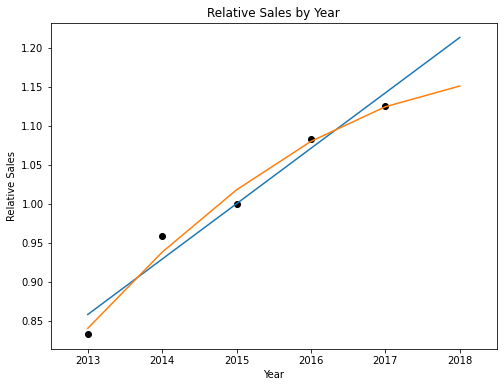

In [ ]:
plt.figure(figsize=(8,6))
plt.plot(years[:-1], annual_sales_avg, 'ko')
plt.plot(years, p1(years), 'C0-')  #Linear growth
plt.plot(years, p2(years), 'C1-')  # quadratic growth

plt.xlim(2012.5, 2018.5)

plt.title("Relative Sales by Year")
plt.ylabel("Relative Sales")
plt.xlabel("Year")
plt.show()

In [ ]:
print(f"2018 Relative Sales by Degree-1 (Linear) Fit = {p1(2018):.4f}")
print(f"2018 Relative Sales by Degree-2 (Quadratic) Fit = {p2(2018):.4f}")


2018 Relative Sales by Degree-1 (Linear) Fit = 1.2132
2018 Relative Sales by Degree-2 (Quadratic) Fit = 1.1509


Visualizing yearly sales

In [ ]:
train_year = train[['sales','year']].groupby(by='year').sum().reset_index()
train_year

,year,sales
0,2013,7941243
1,2014,9135482
2,2015,9536887
3,2016,10357160
4,2017,10733740


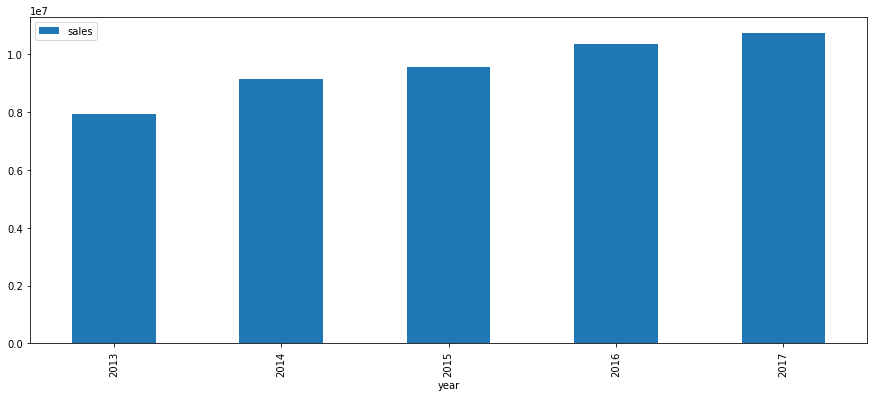

In [ ]:
fig, ax = plt.subplots(figsize=(15,6))
train_year.set_index('year').plot(kind='bar',ax=ax)
plt.show()

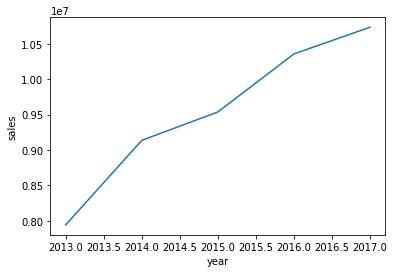

In [ ]:
sns.lineplot(data=train_year, 
             x='year', 
             y='sales')

Visualizing Monthly Sales

In [ ]:
df_month = df[['sales','month']].groupby(by='month').sum().reset_index()
df_month

,month,sales
0,1,2753149.0
1,2,2776177.0
2,3,3666182.0
3,4,4136467.0
4,5,4582437.0
5,6,4726911.0
6,7,5192393.0
7,8,4580655.0
8,9,4130457.0
9,10,3967520.0


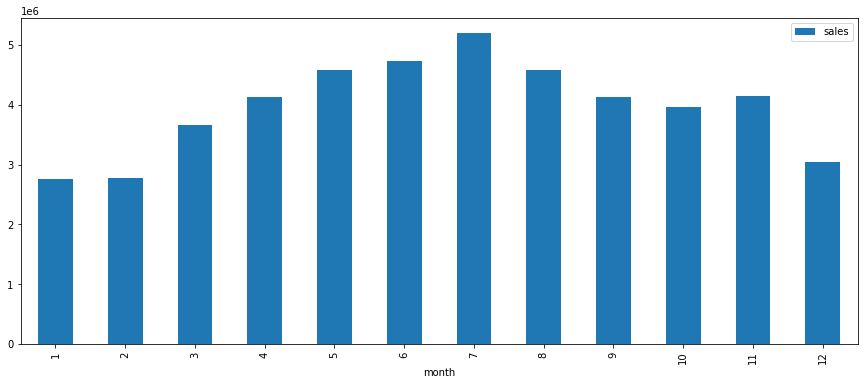

In [ ]:
fig, ax = plt.subplots(figsize=(15,6))
df_month.set_index('month').plot(kind='bar',ax=ax)
plt.show()

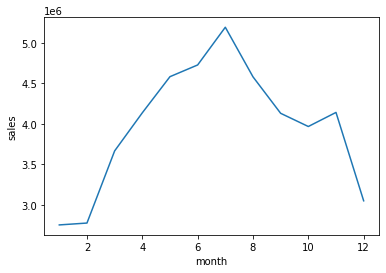

In [ ]:
sns.lineplot(data=df_month, 
             x='month', 
             y='sales')

Seasonal plot

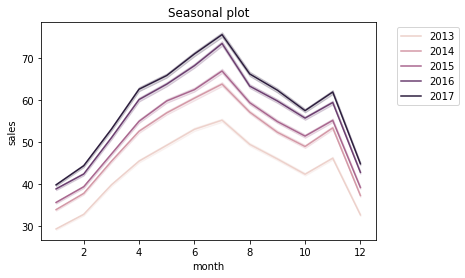

In [ ]:
sns.lineplot(data=train, 
             x='month', 
             y='sales', 
             hue='year', 
             legend='full')

plt.title('Seasonal plot')

# move the legend outside of the main figure
plt.legend(bbox_to_anchor=(1.05, 1), loc=2);

Visualizing sales 

In [ ]:
df_sales = df_indexed['sales']
df_sales

date
2013-01-01    13.0
2013-01-02    11.0
2013-01-03    14.0
2013-01-04    13.0
2013-01-05    10.0
              ... 
2018-03-27     NaN
2018-03-28     NaN
2018-03-29     NaN
2018-03-30     NaN
2018-03-31     NaN
Name: sales, Length: 958000, dtype: float64

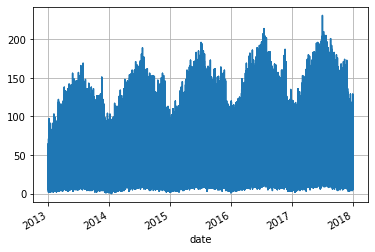

In [ ]:
df_sales.plot(grid=True)

In [ ]:
df_sales_mean = df_sales.rolling(window = 12).mean()
df_sales_mean

date
2013-01-01   NaN
2013-01-02   NaN
2013-01-03   NaN
2013-01-04   NaN
2013-01-05   NaN
              ..
2018-03-27   NaN
2018-03-28   NaN
2018-03-29   NaN
2018-03-30   NaN
2018-03-31   NaN
Name: sales, Length: 958000, dtype: float64

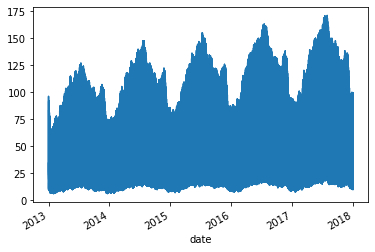

In [ ]:
df_sales_mean.plot()

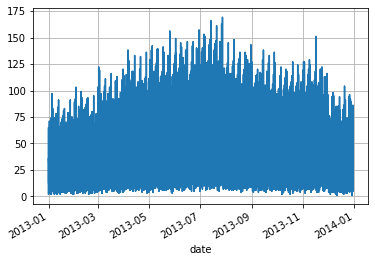

In [ ]:
df_2013 = df_indexed.loc['2013']
df_2013_data = df_2013['sales']
df_2013_data.plot(grid=True)


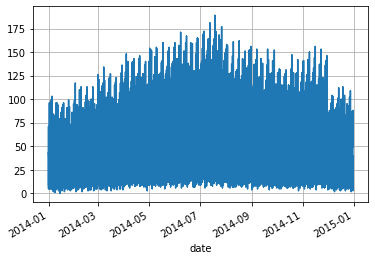

In [ ]:
df_2014 = df_indexed.loc['2014']
df_2014_data = df_2014['sales']
df_2014_data.plot(grid=True)


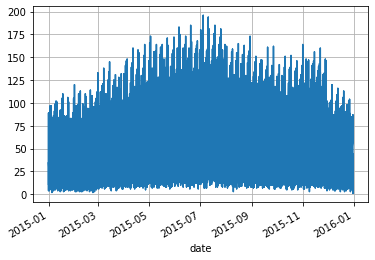

In [ ]:
df_2015 = df_indexed.loc['2015']
df_2015_data = df_2015['sales']
df_2015_data.plot(grid=True)


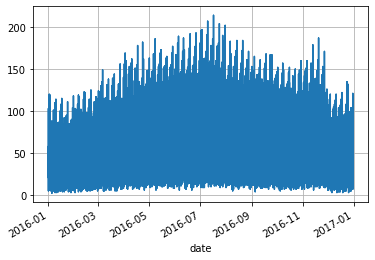

In [ ]:
df_2016 = df_indexed.loc['2016']
df_2016_data = df_2016['sales']
df_2016_data.plot(grid=True)


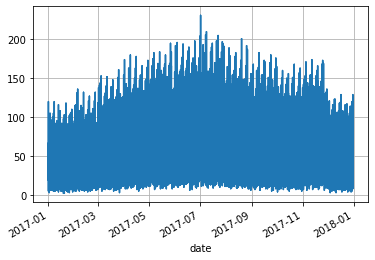

In [ ]:
df_2017 = df_indexed.loc['2017']
df_2017_data = df_2017['sales']
df_2017_data.plot(grid=True)


In [ ]:
import plotly.express as px
fig = px.line(df_non_indexed, x='date', y='sales')

fig.update_xaxes(rangeslider_visible=True)
fig.show()